# **ĐỒ ÁN CUỐI KỲ**
## **Tên bài báo: Keypoint Communities**

- Tác giả: Duncan Zauss, Sven Kreiss, Alexandre Alahi
- Tên hội nghị: ICCV 2021
- Keyword: Human Pose, Pose Estimation, Human Pose Estimation

**Môn : Các vấn đề chọn lọc trong thị giác máy tính - CS420.M11.KHCL**

## **GVHD: TS. Nguyễn Vinh Tiệp**

## **Danh sách nhóm**

NGÔ ĐỨC TUẤN - 18520186

NGUYỄN ANH KHOA - 18520922

LÊ HOÀNG LONG - 18521027

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


***WORKFLOW*** 
1.   Git clone 
2.   Import các thư viện cần thiết (là 1 thư viện tự tạo của tác giả (Openpifpaf)
3.   Chuẩn bị data 
4.   Train 
5.   Evaluate 
6.   Demo
7.   Đánh giá trên tập Crowdpose



#**1. Git clone** 



In [ ]:
%cd /content/drive/MyDrive/keypoint_communities
!git clone  https://github.com/DuncanZauss/Keypoint_Communities.git

#**2. Import các thư viện cần thiết**

boto==2.49.0

certifi==2021.5.30

charset-normalizer==2.0.3

cycler==0.10.0

future==0.18.2

idna==3.2

importlib-metadata==4.6.1

kiwisolver==1.3.1

matplotlib==3.4.2

networkx==2.6.2

numpy==1.21.1

opencv-python>=4.2.0

openpifpaf==0.13.0

pandas==1.3.1

pillow>=8.3.2

pyparsing==2.4.7

pysparkling==0.6.1

python-dateutil==2.8.2

python-json-logger==2.0.2

pytz==2021.1

requests==2.26.0

six==1.16.0

torch==1.9.0

torchvision==0.10.0

typing-extensions==3.10.0.0

urllib3==1.26.6

zipp==3.5.0


In [ ]:
!pip install -r /content/drive/MyDrive/keypoint_communities/Keypoint_Communities/requirements.txt

**Import thư viện của tác giả (OpenPifPaf)**

In [ ]:
!pip install openpifpaf==0.12.14
!python -m openpifpaf.train --version

     |████████████████████████████████| 770 kB 30.4 MB/s 
     |████████████████████████████████| 166 kB 60.6 MB/s 
     |████████████████████████████████| 1.4 MB 41.1 MB/s 
     |████████████████████████████████| 503 kB 37.0 MB/s 
  Created wheel for pysparkling: filename=pysparkling-0.6.1-py3-none-any.whl size=187580 sha256=fac403112a68988dfa97450edfe9db6f8d262756f7fb46b965d70f5f376c7c27
  Stored in directory: /root/.cache/pip/wheels/c8/2e/ac/5336e8ec240e9895bf4f142026f16d0d442af578d339c44aa0
Successfully built pysparkling
  Attempting uninstall: pytz
    Found existing installation: pytz 2018.9
    Uninstalling pytz-2018.9:
      Successfully uninstalled pytz-2018.9


OpenPifPaf 0.12.14


# **3. Chuẩn bị bộ dataset**

##**3.1. COCO Wholebody**

In [ ]:
!wget http://images.cocodataset.org/zips/train2017.zip
!wget http://images.cocodataset.org/zips/val2017.zip
!wget http://images.cocodataset.org/zips/test2017.zip
!mv *.zip "/content/drive/MyDrive/keypoint_communities/"
!unzip /content/drive/MyDrive/keypoint_communities/*.zip -d /content


**Kiểm tra dữ liệu**

In [ ]:
import json
f = open('/content/coco_wholebody_train_v1.0.json')
df = json.load(f)

In [ ]:
len(df['images'])  ##

118287

In [ ]:
!ls /content/train2017 | wc -l
# 118287

104511


In [ ]:
118287 - 104511

13776

In [ ]:
!unzip /content/drive/MyDrive/keypoint_communities/val2017.zip -d /content/

Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
 extracting: /content/val2017/000000212226.jpg  
 extracting: /content/val2017/000000231527.jpg  
 extracting: /content/val2017/000000578922.jpg  
 extracting: /content/val2017/000000062808.jpg  
 extracting: /content/val2017/000000119038.jpg  
 extracting: /content/val2017/000000114871.jpg  
 extracting: /content/val2017/000000463918.jpg  
 extracting: /content/val2017/000000365745.jpg  
 extracting: /content/val2017/000000320425.jpg  
 extracting: /content/val2017/000000481404.jpg  
 extracting: /content/val2017/000000314294.jpg  
 extracting: /content/val2017/000000335328.jpg  
 extracting: /content/val2017/000000513688.jpg  
 extracting: /content/val2017/000000158548.jpg  
 extracting: /content/val2017/000000132116.jpg  
 extracting: /content/val2017/000000415238.jpg  
 extracting: /content/val2017/000000321333.jpg  
 extracting: /content/val2017/000000081738.jpg  
 extracting: /content/val2017/000000577584.jpg  
 extracting:

##**3.2. ApolloCar3D**

In [ ]:
!mkdir data-apollocar3d
%cd data-apollocar3d
!wget https://ad-apolloscape.cdn.bcebos.com/3d-car-understanding-train.tar.gz
!tar -xvf /content/data-apollocar3d/3d-car-understanding-train.tar.gz
!rm /content/data-apollocar3d/3d-car-understanding-train.tar.gz
%cd ..

Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
train/keypoints/180310_024321667_Camera_5/
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0000.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0001.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0002.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0003.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0004.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0005.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0006.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0007.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0008.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0009.txt
train/keypoints/180310_024321667_Camera_5/180310_024321667_Camera_5_0010.txt
train/keypoints/180310_024321667_Camera_5/180310_0243

In [ ]:
!rm -rf /content/data-apollocar3d

In [ ]:
!pip install opencv-python
!rm -rf /content/data-apollocar3d/images/train
!python3 -m openpifpaf.plugins.apollocar3d.apollo_to_coco --split_images

Parsed 1000 images and copied to new directory
Parsed 2000 images and copied to new directory
Parsed 3000 images and copied to new directory
Parsed 4000 images and copied to new directory

Phase:train
Average number of keypoints labelled: 16.2 / 66
JSON files directory:  data-apollocar3d/annotations
Saved 52942 instances over 4083 images 

Phase:val
Average number of keypoints labelled: 16.0 / 66
JSON files directory:  data-apollocar3d/annotations
Saved 2674 instances over 200 images 


In [ ]:
!ls /content/data-apollocar3d/images/val

171206_034625454_Camera_5.jpg  180116_041845153_Camera_5.jpg
171206_035907482_Camera_5.jpg  180116_042243841_Camera_5.jpg
171206_041139639_Camera_5.jpg  180116_042406961_Camera_5.jpg
171206_065841148_Camera_6.jpg  180116_042601203_Camera_5.jpg
171206_070423775_Camera_5.jpg  180116_053456829_Camera_5.jpg
171206_070840267_Camera_5.jpg  180116_053603775_Camera_5.jpg
171206_070959313_Camera_5.jpg  180116_053637003_Camera_5.jpg
171206_071422746_Camera_5.jpg  180116_053707252_Camera_5.jpg
171206_071708234_Camera_5.jpg  180116_053945714_Camera_5.jpg
171206_072104589_Camera_5.jpg  180116_054034065_Camera_5.jpg
171206_072248672_Camera_5.jpg  180116_054107453_Camera_5.jpg
171206_072349683_Camera_5.jpg  180116_054340598_Camera_5.jpg
171206_072620683_Camera_5.jpg  180116_054419130_Camera_5.jpg
171206_073834925_Camera_5.jpg  180116_054722757_Camera_5.jpg
171206_073858940_Camera_5.jpg  180116_054959969_Camera_5.jpg
171206_074429310_Camera_5.jpg  180116_055125258_Camera_5.jpg
171206_074453321_Camera_

#**4.Train model**

In [ ]:
# !python3 -m openpifpaf.train --lr=0.0001 --momentum=0.95 --b-scale=3.0 --epochs=150 --lr-decay 130 140 --lr-decay-epochs=10 --batch-size=16 --weight-decay=1e-5 --dataset=wholebody --wholebody-upsample=2 --basenet=shufflenetv2k16 --loader-workers=16 --wholebody-train-annotations=/content/Keypoint_Communities/data-mscoco/annotations/train.json --wholebody-val-annotations=/content/Keypoint_Communities/data-mscoco/annotations/test.json --wholebody-train-image-dir=/content/test2017/ --wholebody-val-image-dir=/content/test2017/
%cd /content/drive/MyDrive/keypoint_communities
!python3 -m openpifpaf.train --lr=0.0001 --momentum=0.95 --b-scale=3.0 --epochs=50 --lr-decay 130 140 --lr-decay-epochs=10 --batch-size=64 --weight-decay=1e-5 \
--dataset=wholebody --wholebody-upsample=2 --basenet=shufflenetv2k16 --loader-workers=0 --log-interval=1 \
--wholebody-train-annotations=/content/train.json \
--wholebody-val-annotations=/content/val.json \
--wholebody-train-image-dir=/content/train2017/ --wholebody-val-image-dir=/content/val2017/
# nếu báo out of memories giảm batch size /2 

/content/drive/MyDrive/keypoint_communities
INFO:__main__:neural network device: cuda (CUDA available: True, count: 1)
INFO:openpifpaf.network.basenetworks:shufflenetv2k16: stride = 16, output features = 1392
INFO:openpifpaf.network.losses.multi_head:multihead loss: ['wholebody.cif.c', 'wholebody.cif.vec1', 'wholebody.cif.scales1', 'wholebody.caf.c', 'wholebody.caf.vec1', 'wholebody.caf.vec2', 'wholebody.caf.scales1', 'wholebody.caf.scales2'], [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
INFO:__main__:Single GPU training
INFO:openpifpaf.logger:{'type': 'process', 'argv': ['/usr/local/lib/python3.7/dist-packages/openpifpaf/train.py', '--lr=0.0001', '--momentum=0.95', '--b-scale=3.0', '--epochs=50', '--lr-decay', '130', '140', '--lr-decay-epochs=10', '--batch-size=64', '--weight-decay=1e-5', '--dataset=wholebody', '--wholebody-upsample=2', '--basenet=shufflenetv2k16', '--loader-workers=0', '--log-interval=1', '--wholebody-train-annotations=/content/train.json', '--wholebody-val-annotations=/

#**5. Evaluation**

##**5.1. Evaluate 1 ảnh**

###**5.1.1. COCO Wholebody**

In [ ]:
!cp "/content/val2017/000000000139.jpg" -r /content/

In [ ]:
# !gdown --id 1N6VgwKnj8DeyGXCvp1eYgNbRmw6jdfrb
!pip install thop
!pip install xtcocotools 
# !python -m openpifpaf.eval --dataset=wholebody --checkpoint=shufflenetv2k30-wholebody \
# --force-complete-pose --seed-threshold=0.2 --force-complete-caf-th=0.001 --wholebody-val-image-dir="/content" \
# --wholebody-val-annotations="/content/test1.json"

     |████████████████████████████████| 310 kB 30.6 MB/s 
     |████████████████████████████████| 15.7 MB 29.6 MB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.3.post1 requires numpy<1.20,>=1.16.0, but you have numpy 1.21.4 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


###**5.1.2 ApolloCar3D**

In [ ]:
!cp "/content/data-apollocar3d/images/val/180116_041845153_Camera_5.jpg" -r /content/

In [ ]:
import json
 
f= open('/content/data-apollocar3d/annotations/apollo_keypoints_66_val.json')
 
df = json.load(f)
 
for i,index in enumerate(df['images']):
 if index['file_name'] == '180116_041845153_Camera_5.jpg':
  img = index
  id = index['id']
  break
for i,index in enumerate(df['annotations']):
 if index['image_id'] == id:
  print(index)
  label = index
  break
 
out = {
 'info':df['info'],
 'images':[img],
 'annotations':[label],
 'categories':df['categories'],
}
 
with open('test1.json','w') as f:
 json.dump(out, f)

{'image_id': 41845153, 'category_id': 1, 'iscrowd': 0, 'id': 418451534, 'area': 2464, 'bbox': [1533, 1733, 56, 44], 'num_keypoints': 18, 'keypoints': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1537.97, 1774.63, 2.0, 1538.47, 1751.13, 2.0, 1539.32, 1756.73, 2.0, 1552.05, 1737.22, 2.0, 1544.58, 1750.28, 2.0, 1545.6, 1756.39, 2.0, 1548.31, 1761.99, 2.0, 1541.19, 1770.13, 2.0, 1579.36, 1770.98, 2.0, 1576.69, 1763.01, 2.0, 1577.66, 1757.75, 2.0, 1578.68, 1751.81, 2.0, 1579.7, 1738.75, 2.0, 0.0, 0.0, 0.0, 1584.96, 1752.15, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

In [ ]:
!python3 -m openpifpaf.eval \
--dataset=apollo --loader-workers=0 \
--checkpoint shufflenetv2k16-apollo-66 \
--force-complete-pose --seed-threshold=0.2 \
--apollo-eval-long-edge=0 --apollo-val-annotations="test1.json" \
--apollo-val-image-dir='/content' 

INFO:openpifpaf.network.factory:filtering for dataset heads and extending existing heads
INFO:openpifpaf.predictor:neural network device: cuda (CUDA available: True, count: 1)
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
INFO:openpifpaf.plugins.coco.dataset:filter for annotations (min kp=1) ...
INFO:openpifpaf.plugins.coco.dataset:... done.
INFO:openpifpaf.plugins.coco.dataset:Images: 1
tcmalloc: large alloc 2437349376 bytes == 0x557d3e540000 @  0x7f5763926001 0x7f57612751af 0x7f57612cbc23 0x7f57612cca87 0x7f576136e973 0x557cb311046c 0x557cb3110240 0x557cb3184627 0x557cb3111afa 0x557cb317fc0d 0x557cb317eced 0x557cb3112271 0x557cb3155409 0x557cb3110c52 0x557cb3183c25 0x557cb3112039 0x557cb3155409 0x557cb3110c52 0x557cb3183c25 0x557cb3112039 0x557cb3112698 0x557cb3180fe4 0x557cb317eced 0x557cb3111bda 0x557cb317f915 0x557cb317eced 0x557cb3111bda 0x557cb3183d00 0x557cb31

##**5.2. Evaluate toàn bộ dataset**

###**5.2.1. COCO Wholebody**

In [ ]:
!python -m openpifpaf.eval --dataset=wholebody --checkpoint=shufflenetv2k30-wholebody \
--force-complete-pose --seed-threshold=0.2 --force-complete-caf-th=0.001 --wholebody-val-image-dir="/content/val2017" \
--wholebody-val-annotations="/content/drive/MyDrive/keypoint_communities/coco_wholebody_val_v1.0.json"

Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
INFO:__main__:image 734 / 2346, last loop: 1.109s, images per second=0.9
INFO:openpifpaf.decoder.cifcaf:9 annotations: [88, 8, 1, 0, 0, 0, 0, 0, 0]
INFO:openpifpaf.predictor:batch 735: 000000248284.jpg
INFO:__main__:image 735 / 2346, last loop: 0.585s, images per second=0.9
INFO:openpifpaf.decoder.cifcaf:1 annotations: [20]
INFO:openpifpaf.predictor:batch 736: 000000002532.jpg
INFO:__main__:image 736 / 2346, last loop: 0.461s, images per second=0.9
INFO:openpifpaf.decoder.cifcaf:4 annotations: [78, 1, 1, 0]
INFO:openpifpaf.predictor:batch 737: 000000477689.jpg
INFO:__main__:image 737 / 2346, last loop: 0.525s, images per second=0.9
INFO:openpifpaf.decoder.cifcaf:95 annotations: [52, 14, 13, 4, 3, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

####**Bảng kết quả evaluation cho tập COCO WholeBody**

In [1]:
import pandas as pd

In [2]:
results_dict={'WB':['60.4%', '85.5%', '66.2%', '47.4%', '67.8%'],
              'body':['85.5%', '88.1%', '80.0%', '95.4%', '78.5%'],
              'foot':['66.2%', '76.1%', '68.0%', '89.2%', '57.7%'],
              'face':['47.4%', '57.7%', '46.0%', '57.4%', '18.0%'],
              'hand':['67.8%', '77.5%', '71.4%', '92.4%', '57.0%'],}
pd.DataFrame(results_dict)

,WB,body,foot,face,hand
0,60.4%,85.5%,66.2%,47.4%,67.8%
1,85.5%,88.1%,76.1%,57.7%,77.5%
2,66.2%,80.0%,68.0%,46.0%,71.4%
3,47.4%,95.4%,89.2%,57.4%,92.4%
4,67.8%,78.5%,57.7%,18.0%,57.0%


- **'0'**: **AP**
- **'1'**: **AP(0.5)**
- **'2'**: **AP(0.75)**
- **'3'**: **AP(M)**
- **'4'**: **AP(L)**

###**5.2.2. ApolloCar3D**

In [ ]:
!python3 -m openpifpaf.eval \
--dataset=apollo --loader-workers=8 \
--checkpoint shufflenetv2k16-apollo-66 \
--force-complete-pose --seed-threshold=0.2 \
--apollo-eval-long-edge=0

INFO:openpifpaf.network.factory:filtering for dataset heads and extending existing heads
INFO:openpifpaf.predictor:neural network device: cuda (CUDA available: True, count: 1)
loading annotations into memory...
Done (t=0.09s)
creating index...
index created!
loading annotations into memory...
Done (t=0.09s)
creating index...
index created!
INFO:openpifpaf.plugins.coco.dataset:filter for annotations (min kp=1) ...
INFO:openpifpaf.plugins.coco.dataset:... done.
INFO:openpifpaf.plugins.coco.dataset:Images: 200
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
tcmalloc: large alloc 243734937

####**Bảng kết quả evaluation cho tập ApolloCar3D**

In [4]:
results_dict={'Car':['64.2%', '80.1%', '69.7%', '59.1%', '82.3%', '89.6%'],}
pd.DataFrame(results_dict)

,Car
0,64.2%
1,80.1%
2,69.7%
3,59.1%
4,82.3%
5,89.6%


- **'0'**: **AP**
- **'1'**: **AP(0.5)**
- **'2'**: **AP(0.75)**
- **'3'**: **AP(M)**
- **'4'**: **AP(L)**
- **'5'**: **Detection Rate**

In [ ]:
%cd /content/
!gdown --id 1thErEToRbmM9uLNi1JXXfOsaS5VK2FXf

/content
Downloading...
From: https://drive.google.com/uc?id=1thErEToRbmM9uLNi1JXXfOsaS5VK2FXf
To: /content/coco_wholebody_train_v1.0.json
100% 3.16G/3.16G [00:42<00:00, 73.9MB/s]


#**6. Demo**

##**6.1. Ước lượng tư thế cho người**
- Chúng tôi sử dụng checkpoint là shuffnetv2k30-wholebody

In [3]:
!python -m openpifpaf.predict /content/IMG_0610.jpg --checkpoint=shufflenetv2k30-wholebody --line-width=2 --show --save-all


INFO:__main__:neural network device: cpu (CUDA available: False, count: 0)
INFO:openpifpaf.predictor:neural network device: cpu (CUDA available: False, count: 0)
tcmalloc: large alloc 3124969472 bytes == 0x55578f83e000 @  0x7ff7a7eb3b6b 0x7ff7a7ed3379 0x7ff69fefdcde 0x7ff69feff452 0x7ff6f1f26cf3 0x7ff6f1f27867 0x7ff6f227acc1 0x7ff6f1d2e2ba 0x7ff6f1d2f695 0x7ff6f268c6e6 0x7ff6f233be27 0x7ff6f3c599ac 0x7ff6f3c5a602 0x7ff6f23a53cf 0x7ff6f1d2b91c 0x7ff6f28070e6 0x7ff6f22b7f4f 0x7ff6f1d209ab 0x7ff6f27fe366 0x7ff6f25299f8 0x7ff6f1d26785 0x7ff6f27fe21a 0x7ff6f226cf8c 0x7ff6f1d1fd9b 0x7ff6f27fe17a 0x7ff6f226c2a7 0x7ff6f1d1f96a 0x7ff6f27fe502 0x7ff6f25f5fd6 0x7ff79b612cef 0x5556f0c114b0
tcmalloc: large alloc 3124969472 bytes == 0x555849c72000 @  0x7ff7a7eb3b6b 0x7ff7a7ed3379 0x7ff69fefdcde 0x7ff69feff452 0x7ff6f1b5eab9 0x7ff6f1b5f817 0x7ff6f1fa1dc9 0x7ff6f268544a 0x7ff6f26638fe 0x7ff6f236bd60 0x7ff79b9ae721 0x7ff6f1fadde5 0x7ff6f2802874 0x7ff6f2532883 0x7ff6f1c78af8 0x7ff6f1e828bc 0x7ff6f1e7dea

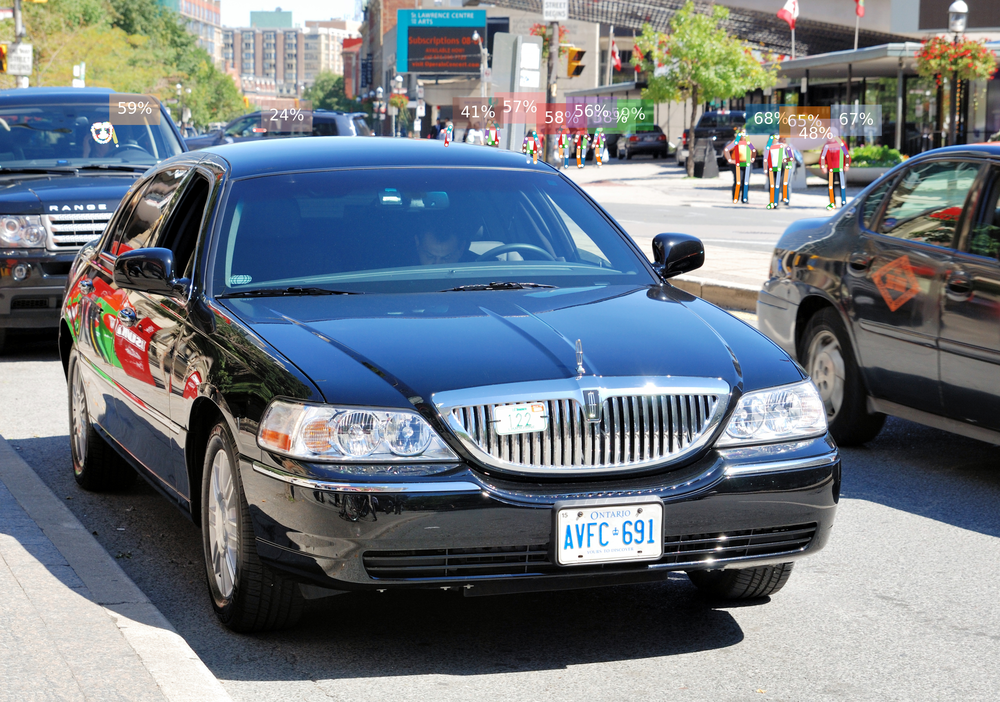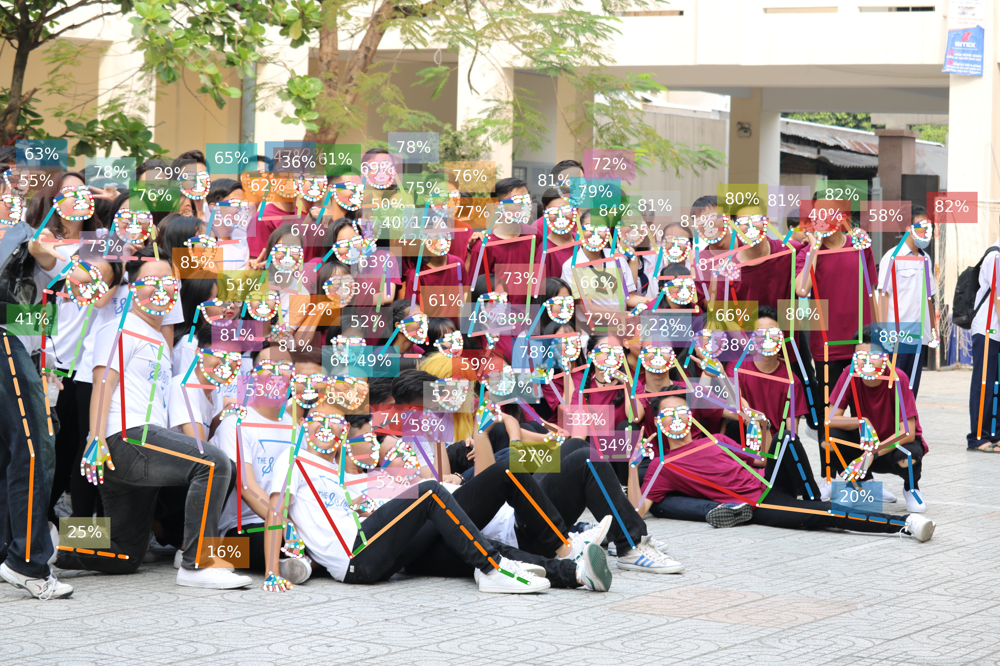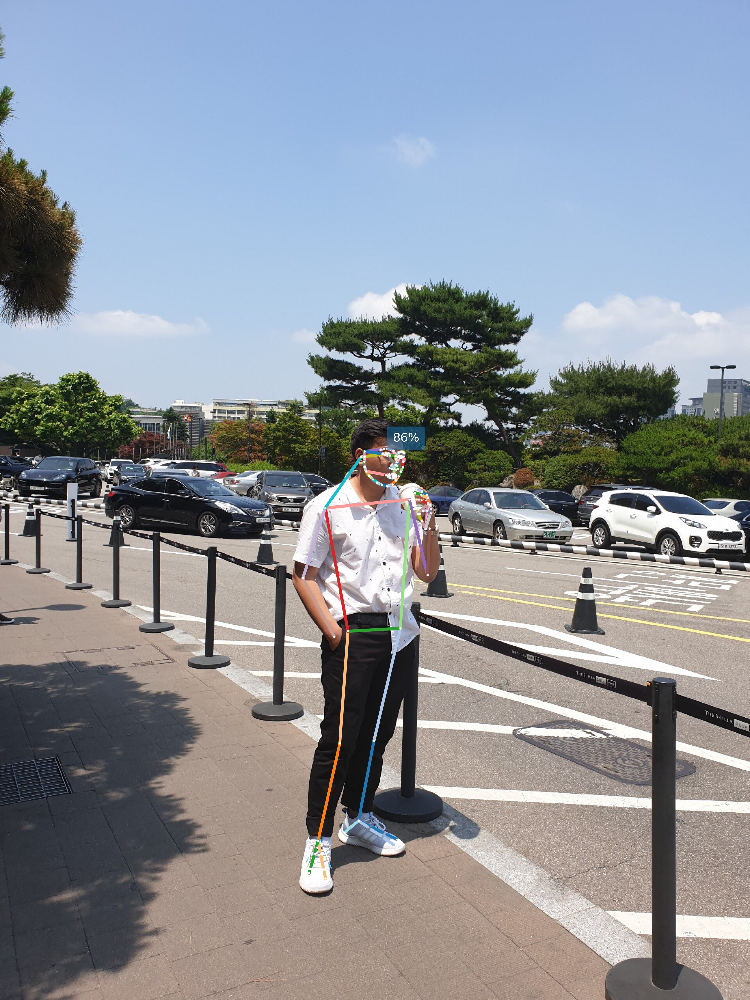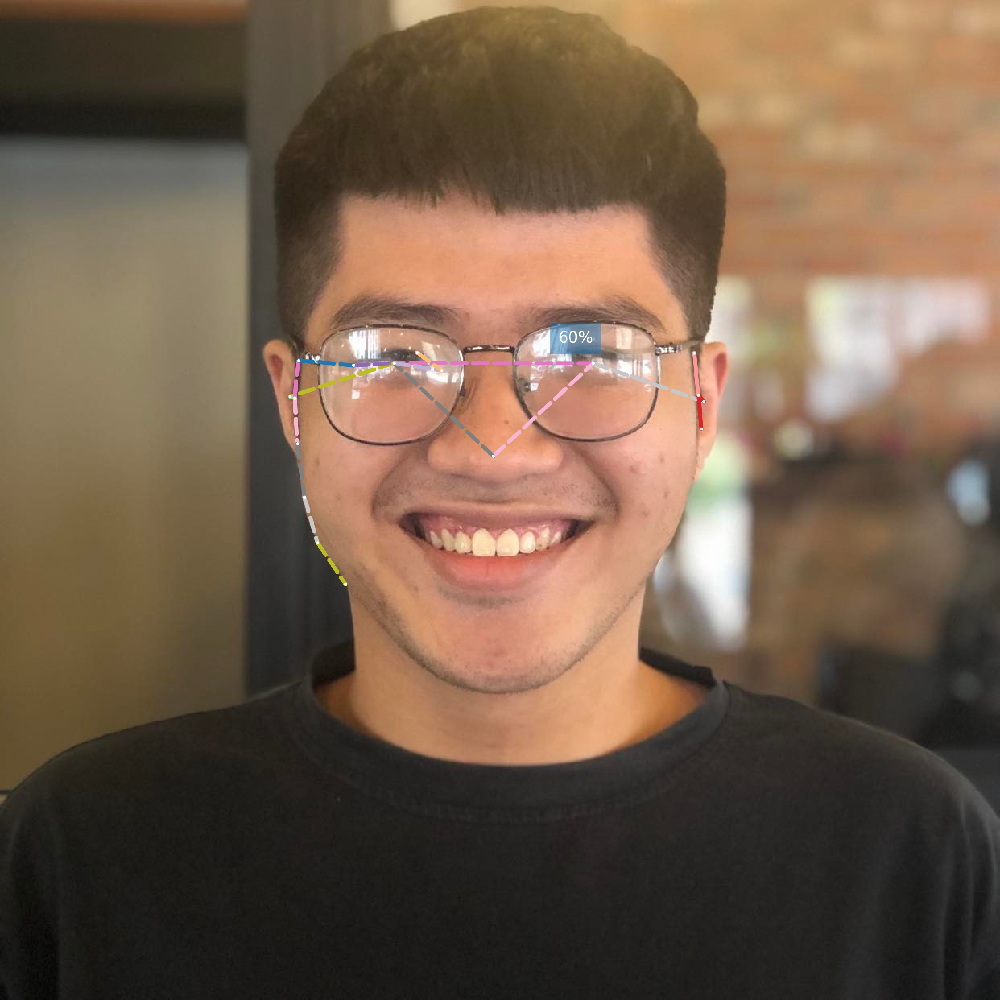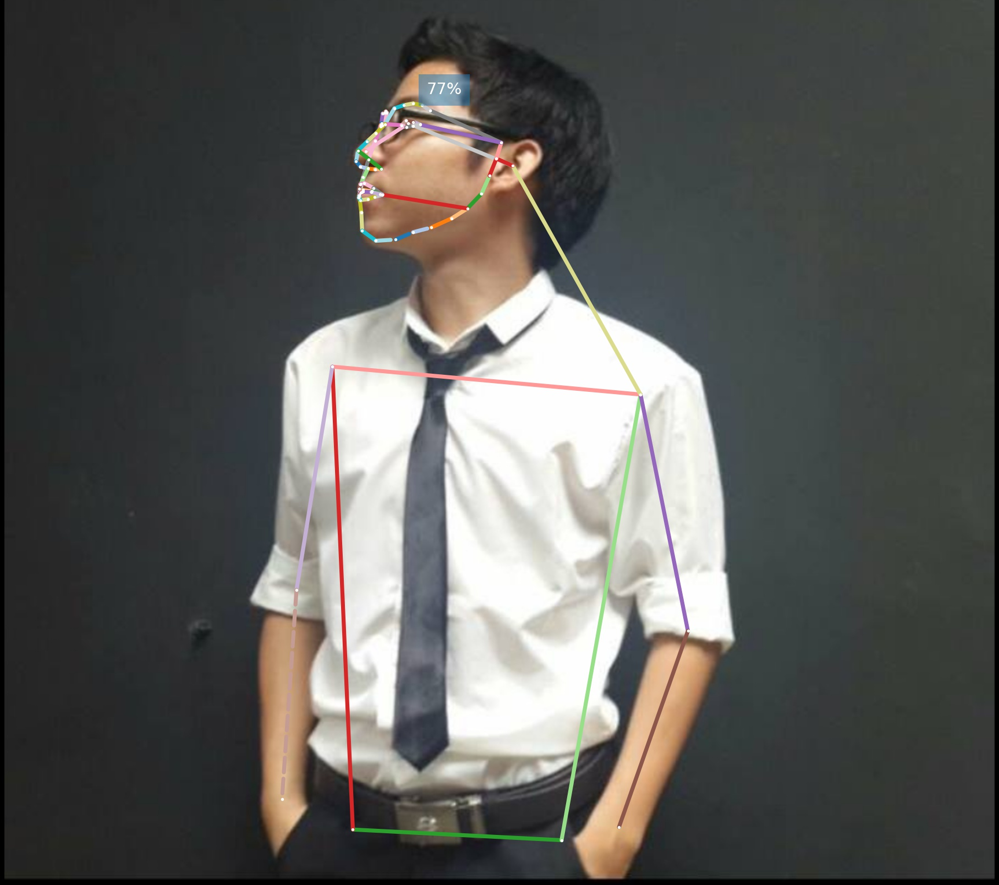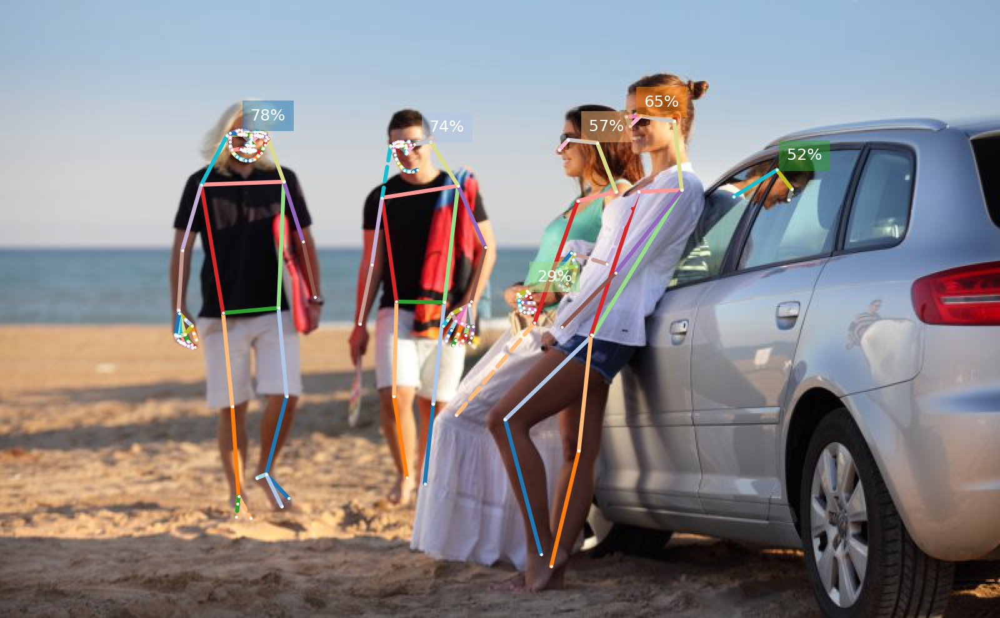

***Nhận xét:*** 
- Hình đầu tiên, ta thấy hệ thống ước lượng tư thế người rất tốt khi detect được cả những người đứng ở xa và một người ngồi chỉ hiện đầu trong chiếc xe góc xa bên trái.
- Hình thứ hai, với số lượng người đông đảo lên đến gần 50 người thì hệ thống của tác giả vẫn ước lượng tốt gần như tối đa số lượng đối tượng có trong ảnh.
- Hình thứ sáu: Ta có thể thấy hệ thống của tác giả đạt kết quả tốt khi có thể ước lượng tư thế người từ trong gương xe ô tô, vốn chỉ là ảnh ảo chứ không phải là người thật.
- Chúng tôi test một số ảnh của các thành viên của nhóm:
    + Hình thứ ba, thứ năm: hệ thống đều ước lượng các tư thế cho người đều rất tốt trên các ảnh test của chúng tôi
    + Hình thứ tư: hệ thống này chỉ ước lượng được phân nửa khuôn mặt trái (nhìn theo hướng của đối tượng). Điều này có thể do việc ảnh hưởng từ ảnh đã được photoshop mặt cũng như làm mờ background dẫn đến ước lượng kém như vậy.


##**6.2. Ước lượng tư thế cho ô tô**
- Chúng tôi sử dụng checkpoint là shuffnetv2k30-apollo-66

In [ ]:
!python -m openpifpaf.predict /content/Tuan.jpg --checkpoint=shufflenetv2k30-apollo-66 --image-dpi-factor=0.25 --line-width=2 --caf-th=0.2 --seed-threshold=0.2 --show --save-all

INFO:__main__:neural network device: cpu (CUDA available: False, count: 0)
Downloading: "http://github.com/DuncanZauss/openpifpaf_assets/releases/download/v0.1.0/sk30_apollo_66kp.pkl" to /root/.cache/torch/hub/checkpoints/sk30_apollo_66kp.pkl
100% 148M/148M [00:01<00:00, 85.6MB/s]
INFO:openpifpaf.predictor:neural network device: cpu (CUDA available: False, count: 0)
tcmalloc: large alloc 1260593152 bytes == 0x556d4fc38000 @  0x7f02d1570b6b 0x7f02d1590379 0x7f01c95bacde 0x7f01c95bc452 0x7f021b5e3cf3 0x7f021b5e4867 0x7f021b937cc1 0x7f021b3eb2ba 0x7f021b3ec695 0x7f021bd496e6 0x7f021b9f8e27 0x7f021d3169ac 0x7f021d317602 0x7f021ba623cf 0x7f021b3e891c 0x7f021bec40e6 0x7f021b974f4f 0x7f021b3dd9ab 0x7f021bebb366 0x7f021bbe69f8 0x7f021b3e3785 0x7f021bebb21a 0x7f021b929f8c 0x7f021b3dcd9b 0x7f021bebb17a 0x7f021b9292a7 0x7f021b3dc96a 0x7f021bebb502 0x7f021bcb2fd6 0x7f02c4ccfcef 0x556d05d654b0
tcmalloc: large alloc 1260593152 bytes == 0x556d9ae6a000 @  0x7f02d1570b6b 0x7f02d1590379 0x7f01c95bacde 0

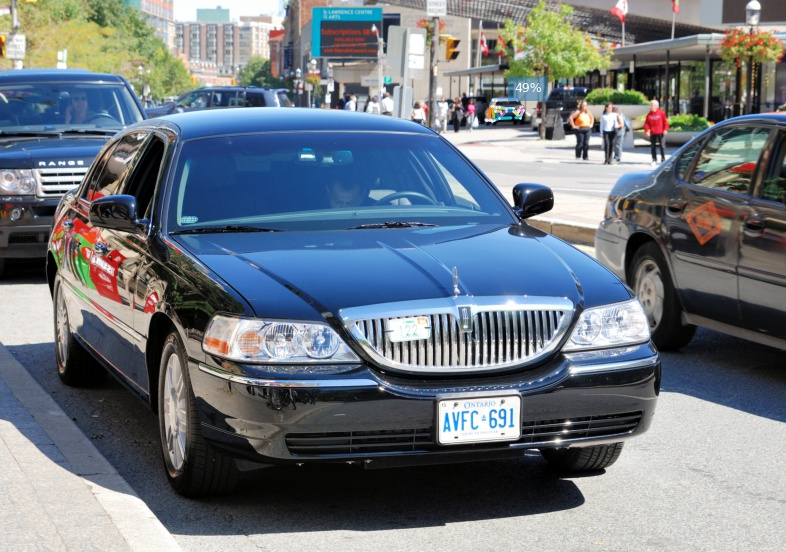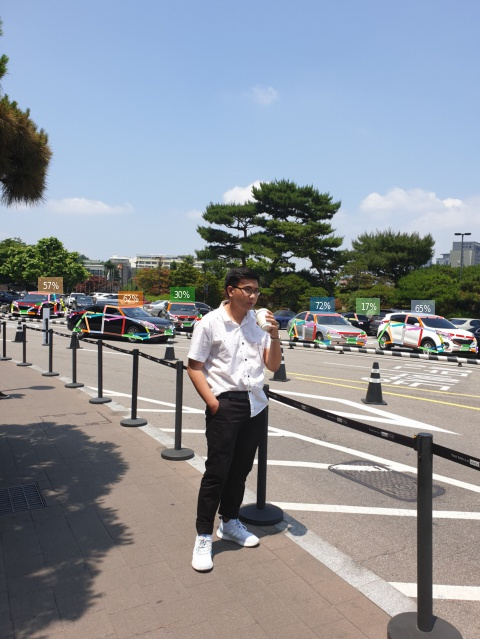

***Nhận xét***:
- Hình đầu tiên: Hệ thống chỉ ước lượng được chiếc ô tô nằm ở xa tít góc phải của hình, trong khi 3 xe ô tô nằm gần nhất thì không thể ước lượng được. Lí do là 3 xe này nằm gần nhau, xe này che khuất xe kia làm cho hệ thống nhận diện ra đây là một khối hình thù dính liền với nhau và điều đó khiến hệ thống không thể nhận ra được một khối hình ô tô hoàn chỉnh.
- Hình thứ hai: hệ thống detect rất tốt ước lượng các tư thế ô tô có trong hình.

##**6.3. Demo realtime trên webcam/video**

- Với webcam, ta cần chạy đoạn command sau (tuy nhiên nhóm chúng tôi chưa fix được lỗi không bật được webcam)

In [8]:
!python -m openpifpaf.video --source=0 --checkpoint=shufflenetv2k16-wholebody --long-edge=321 --horizontal-flip --show

INFO:__main__:neural network device: cpu (CUDA available: False, count: 0)
INFO:openpifpaf.predictor:neural network device: cpu (CUDA available: False, count: 0)
INFO:openpifpaf.show.animation_frame:video output = None
[ WARN:0] global /io/opencv/modules/videoio/src/cap_v4l.cpp (802) open VIDEOIO ERROR: V4L: can't open camera by index 0
INFO:openpifpaf.stream:no more images captured


- Với video, ta cần upload video và path vào đường dẫn với đoạn command sau:

In [4]:
%cd /content
import matplotlib
!python -m openpifpaf.video -h
!python -m openpifpaf.video --source=/content/IMG_0607.mp4 --checkpoint=shufflenetv2k16-wholebody --long-edge=321 --horizontal-flip --show --video-output

/content
usage: python3 -m openpifpaf.video [options]

Video demo application.

Use --scale=0.2 to reduce the input image size to 20%.
Use --json-output for headless processing.

Example commands:
    python3 -m pifpaf.video --source=0  # default webcam
    python3 -m pifpaf.video --source=1  # another webcam

    # streaming source
    python3 -m pifpaf.video --source=http://127.0.0.1:8080/video

    # file system source (any valid OpenCV source)
    python3 -m pifpaf.video --source=docs/coco/000000081988.jpg

Trouble shooting:
* MacOSX: try to prefix the command with "MPLBACKEND=MACOSX".

optional arguments:
  -h, --help            show this help message and exit
  --version             show program's version number and exit
  --source SOURCE       OpenCV source url. Integer for webcams. Or ipwebcam
                        urls (rtsp/rtmp). Use "screen" for screen grabs.
                        (default: 0)
  --video-output [VIDEO_OUTPUT]
                        video output file or 

#**7. Đánh giá trên tập CrowdPose**

- Lấy data về

In [ ]:
!mkdir data-crowdpose
%cd data-crowdpose
!gdown --id 1VprytECcLtU4tKP32SYi_7oDRbw7yUTL
!unzip /content/data-crowdpose/images.zip

Streaming output truncated to the last 5000 lines.
  inflating: images/115000.jpg       
  inflating: images/115001.jpg       
  inflating: images/115002.jpg       
  inflating: images/115003.jpg       
  inflating: images/115004.jpg       
  inflating: images/115005.jpg       
  inflating: images/115006.jpg       
  inflating: images/115007.jpg       
  inflating: images/115008.jpg       
  inflating: images/115009.jpg       
  inflating: images/115010.jpg       
  inflating: images/115011.jpg       
  inflating: images/115012.jpg       
  inflating: images/115013.jpg       
  inflating: images/115014.jpg       
  inflating: images/115015.jpg       
  inflating: images/115016.jpg       
  inflating: images/115017.jpg       
  inflating: images/115018.jpg       
  inflating: images/115019.jpg       
  inflating: images/115020.jpg       
  inflating: images/115021.jpg       
  inflating: images/115022.jpg       
  inflating: images/115023.jpg       
  inflating: images/115024.jpg       

In [ ]:
%cd /content

/content


In [6]:
!pip install thop
!pip install xtcocotools
!pip install openpifpaf==0.12.14
!python -m openpifpaf.train --version

     |████████████████████████████████| 310 kB 30.1 MB/s 
     |████████████████████████████████| 15.7 MB 57.7 MB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.3.post1 requires numpy<1.20,>=1.16.0, but you have numpy 1.21.4 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


     |████████████████████████████████| 770 kB 30.3 MB/s 
     |████████████████████████████████| 166 kB 58.3 MB/s 
     |████████████████████████████████| 1.4 MB 50.0 MB/s 
     |████████████████████████████████| 503 kB 42.5 MB/s 
  Created wheel for pysparkling: filename=pysparkling-0.6.1-py3-none-any.whl size=187580 sha256=7564e0cc1b55c60e8b8e7276ad9ff88d0d1812e7a7a5d4fcab6fa8b21467c630
  Stored in directory: /root/.cache/pip/wheels/c8/2e/ac/5336e8ec240e9895bf4f142026f16d0d442af578d339c44aa0
Successfully built pysparkling
  Attempting uninstall: pytz
    Found existing installation: pytz 2018.9
    Uninstalling pytz-2018.9:
      Successfully uninstalled pytz-2018.9


OpenPifPaf 0.12.14


##**7.1 Evaluation**

In [ ]:
!python3 -m openpifpaf.eval -h
!python3 -m openpifpaf.eval \
--dataset=crowdpose --loader-workers=0 \
--checkpoint resnet50-crowdpose \
--force-complete-pose --seed-threshold=0.2 \
--crowdpose-eval-long-edge=0 \
--crowdpose-image-dir='/content/data-crowdpose/images'

Streaming output truncated to the last 5000 lines.
INFO:openpifpaf.predictor:batch 361: 108138.jpg
INFO:__main__:image 361 / 2000, last loop: 3.774s, images per second=0.2
INFO:openpifpaf.decoder.cifcaf:19 annotations: [9, 8, 6, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
INFO:openpifpaf.predictor:batch 362: 116331.jpg
INFO:__main__:image 362 / 2000, last loop: 9.187s, images per second=0.2
INFO:openpifpaf.decoder.cifcaf:36 annotations: [14, 12, 11, 12, 12, 12, 9, 9, 4, 2, 3, 2, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
INFO:openpifpaf.predictor:batch 363: 108139.jpg
INFO:__main__:image 363 / 2000, last loop: 3.820s, images per second=0.2
INFO:openpifpaf.decoder.cifcaf:13 annotations: [2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
INFO:openpifpaf.predictor:batch 364: 108142.jpg
INFO:__main__:image 364 / 2000, last loop: 4.174s, images per second=0.2
INFO:openpifpaf.decoder.cifcaf:6 annotations: [14, 12, 1, 1, 1, 1]
INFO:openpifpaf.predictor:batch 365: 116338.

###**Bảng kết quả evaluation cho tập CrowdPose**

In [5]:
results_dict={'WB':['66.2%', '86.6%', '71.0%', '52.8%', '70.0%'],}
pd.DataFrame(results_dict)

,WB
0,66.2%
1,86.6%
2,71.0%
3,52.8%
4,70.0%


- **'0'**: **AP**
- **'1'**: **AP(0.5)**
- **'2'**: **AP(0.75)**
- **'3'**: **AP(M)**
- **'4'**: **AP(L)**

##**7.2 Test**

In [ ]:
!python -m openpifpaf.predict /content/7.jpg --checkpoint=resnet50-crowdpose --line-width=2 --show --save-all

INFO:__main__:neural network device: cpu (CUDA available: False, count: 0)
INFO:openpifpaf.predictor:neural network device: cpu (CUDA available: False, count: 0)
INFO:openpifpaf.decoder.cifcaf:59 annotations: [10, 8, 8, 7, 6, 6, 4, 4, 6, 5, 5, 4, 5, 6, 5, 5, 6, 5, 4, 6, 4, 4, 7, 4, 4, 4, 4, 4, 4, 3, 4, 4, 4, 4, 3, 3, 3, 3, 3, 4, 3, 3, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2]
INFO:openpifpaf.predictor:batch 0: /content/7.jpg
<Figure size 3840x2560 with 1 Axes>


- Kết quả khi predict trên tập crowdpose cho ước lượng tư thế người

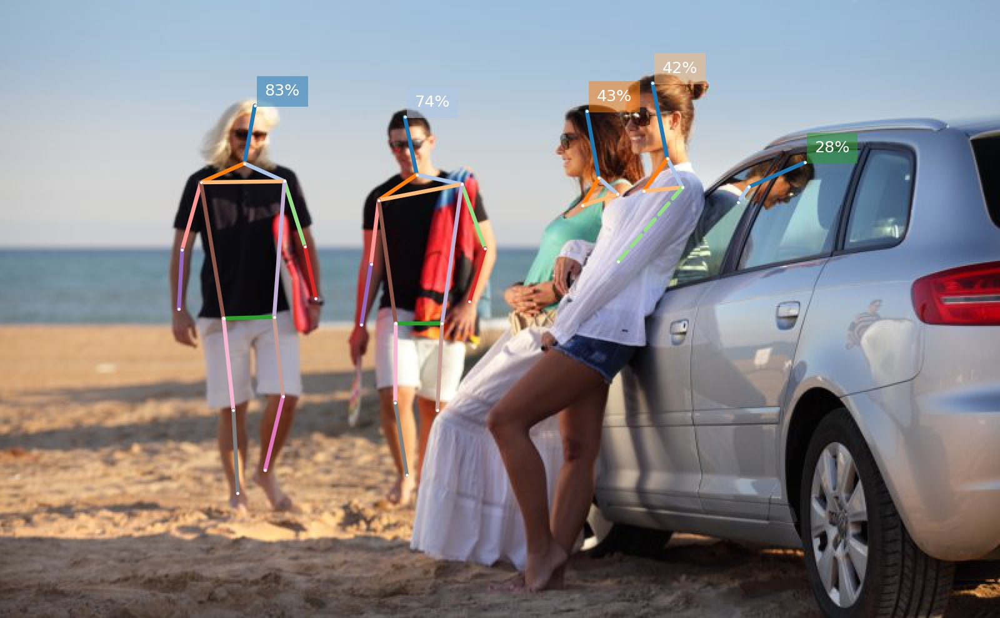

- ***Nhận xét***: Ảnh kết quả ta thấy khi đánh giá trên tập crowdpose cho ra kết quả ước lượng tư thế người không tốt lắm so với tập COCO WholeBody. Một phần cũng là vì tập crowdpose có ít keypoint được gán nhãn hơn (14 < 133 keypoints) do đó ta có thể thấy ở đây, ảnh cô gái mặc quần short, từ vùng lưng trở xuống, phương pháp của tác giả không thể ước lượng được. Đặc biệt có thể thấy keypoint trên khuôn mặt rất ít, nó chỉ là một trục dọc xuống mặt, không thể chi tiết bằng COCO WholeBody do nó được annotate lên tới 68 keypoints cho mặt.